In [ ]:
#face detection with CNN

In [9]:
import cv2
import dlib
from imutils import face_utils
import matplotlib.pyplot as plt


In [ ]:
def detect_CNN(imgpath):
  frame = cv2.imread(imgpath)
  frame = cv2.cvtColor(frame , cv2.COLOR_BGR2RGB)

  gray = cv2.cvtColor( frame , cv2.COLOR_BGR2GRAY)

  cnnfacedetect = dlib.cnn_face_detection_model_v1("mmod_human_face_detector.dat")
  rects = cnnfacedetect(gray , 1)
  for (i , rect) in enumerate(rects):
    x1 = rect.rect.left()
    y1 =  rect.rect.top()
    x2 = rect.rect.right()
    y2 = rect.rect.bottom()

    cv2.rectangle(frame , (x1,y1) , (x2,y2) , (0,255,0) ,3)
  plt.imshow(frame)
  plt.show()

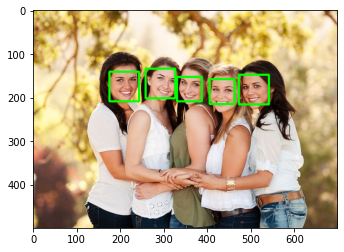

In [ ]:
detect_CNN('2.jpg')

In [14]:
from google.colab.patches import cv2_imshow
def detectVidDlibCNN(vidpath):

    video_capture = cv2.VideoCapture(vidpath)
    flag = 0
    dnnFaceDetector = dlib.cnn_face_detection_model_v1("mmod_human_face_detector.dat")

    
    fourcc = cv2.VideoWriter_fourcc(*'MJPG')
    out = cv2.VideoWriter('outputHOG.avi',fourcc,20.0,(int(video_capture.get(3)),int(video_capture.get(4))))
    while True:
        # Capture frame-by-frame
        ret, frame = video_capture.read()
        #frame  = cv2.resize(frame,(512,512))
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        rects = dnnFaceDetector(gray, 1)

        for (i, rect) in enumerate(rects):

            x1 = rect.rect.left()
            y1 = rect.rect.top()
            x2 = rect.rect.right()
            y2 = rect.rect.bottom()

            # Rectangle around the face
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Display the video output
        out.write(frame)
        cv2_imshow( frame)

        # Quit video by typing Q
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    video_capture.release()
    cv2.destroyAllWindows()

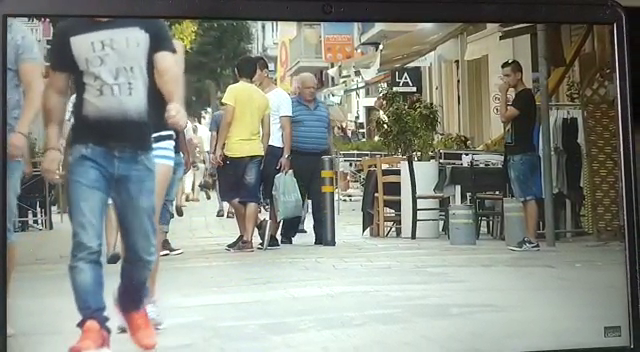

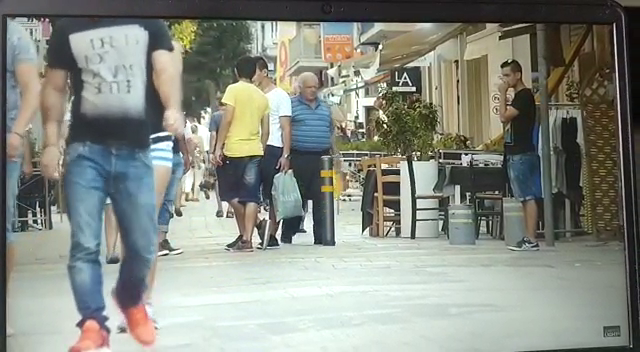

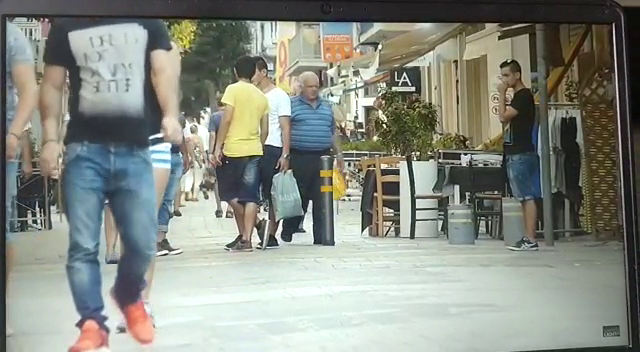

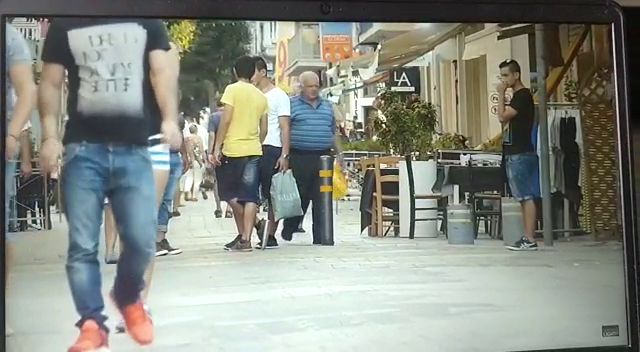

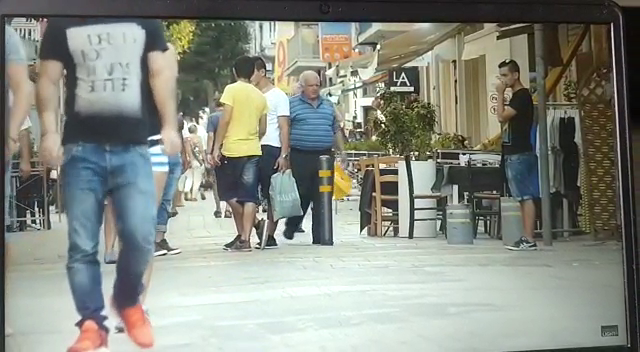

...

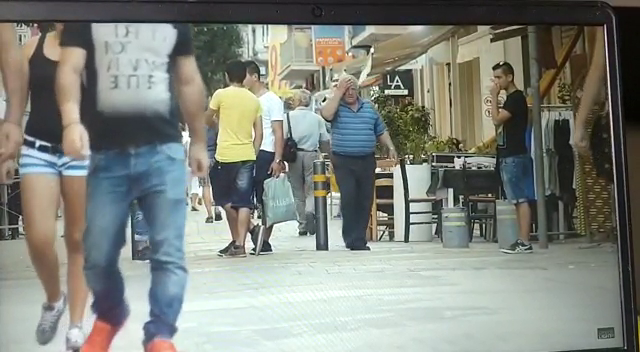

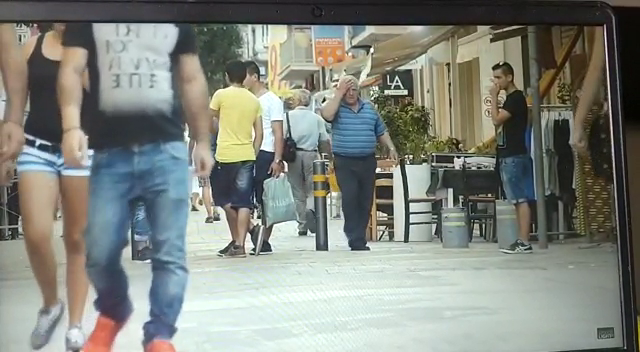

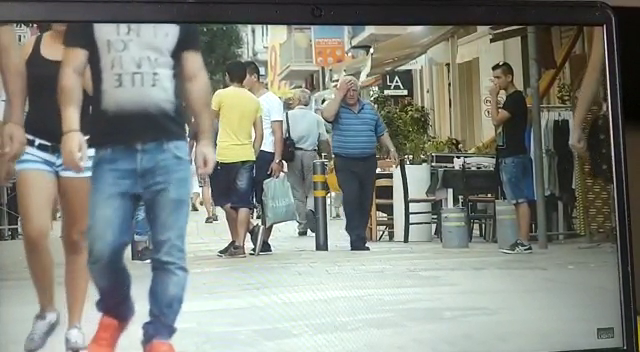

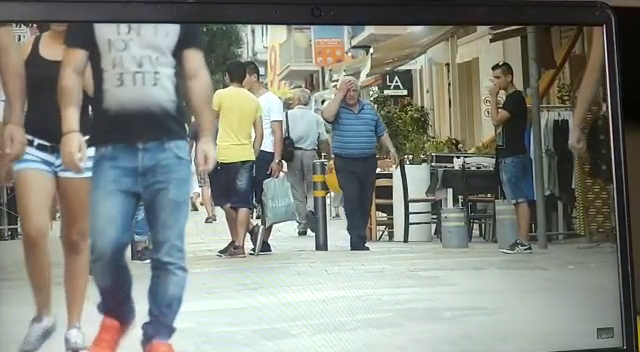

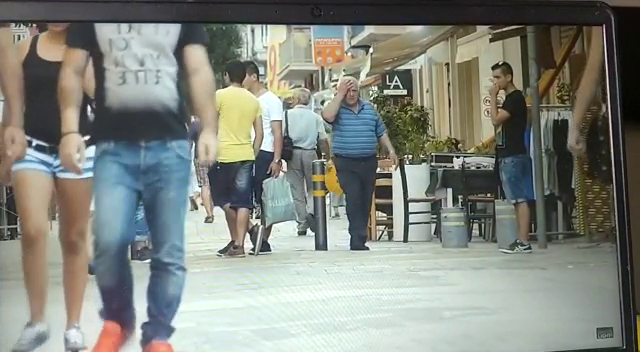

error: ignored

In [15]:
detectVidDlibCNN('1.mp4')